In [ ]:
#run this once
!pip install librosa
!pip install gdown -U --no-cache-dir

In [1]:
#get the files
import gdown
url = 'https://drive.google.com/drive/folders/1rDbrXwWj6smXSmK3EkkxUTkP4AtauEK8'
gdown.download_folder(url)

Retrieving folder list


Processing file 1fJJDv_nB1kFtYBp42BEOihODvh6VpcwX Digital Piano Major.wav
Processing file 1sdILu-SqewcSkRgR_10LR9fl3jy-aZh4 Digital Piano Minor.wav
Processing file 1zkAOMXD_bnqe432nGDg_rpv8PhdAYpTe Guitar Major.wav
Processing file 1ydlka1GAX7r2kd5QFhPLRregsObWPcC8 Guitar Minor.wav
Processing file 1Aep8eWi0zTH_8NyKOV0RLmGqDXuOM8EQ scale.wav
Building directory structure completed


Retrieving folder list completed
Building directory structure
Downloading...
From: https://drive.google.com/uc?id=1fJJDv_nB1kFtYBp42BEOihODvh6VpcwX
To: c:\Users\gerom\OneDrive - Mariano Marcos State University\Thesis\lossy-to-lossless-transcoding\audio\Digital Piano Major.wav
100%|██████████| 14.0M/14.0M [00:00<00:00, 15.4MB/s]
Downloading...
From: https://drive.google.com/uc?id=1sdILu-SqewcSkRgR_10LR9fl3jy-aZh4
To: c:\Users\gerom\OneDrive - Mariano Marcos State University\Thesis\lossy-to-lossless-transcoding\audio\Digital Piano Minor.wav
100%|██████████| 14.2M/14.2M [00:01<00:00, 13.8MB/s]
Downloading...
From: https://drive.google.com/uc?id=1zkAOMXD_bnqe432nGDg_rpv8PhdAYpTe
To: c:\Users\gerom\OneDrive - Mariano Marcos State University\Thesis\lossy-to-lossless-transcoding\audio\Guitar Major.wav
100%|██████████| 14.3M/14.3M [00:00<00:00, 14.5MB/s]
Downloading...
From: https://drive.google.com/uc?id=1ydlka1GAX7r2kd5QFhPLRregsObWPcC8
To: c:\Users\gerom\OneDrive - Mariano Marcos State Univ

['c:\\Users\\gerom\\OneDrive - Mariano Marcos State University\\Thesis\\lossy-to-lossless-transcoding\\audio\\Digital Piano Major.wav',
 'c:\\Users\\gerom\\OneDrive - Mariano Marcos State University\\Thesis\\lossy-to-lossless-transcoding\\audio\\Digital Piano Minor.wav',
 'c:\\Users\\gerom\\OneDrive - Mariano Marcos State University\\Thesis\\lossy-to-lossless-transcoding\\audio\\Guitar Major.wav',
 'c:\\Users\\gerom\\OneDrive - Mariano Marcos State University\\Thesis\\lossy-to-lossless-transcoding\\audio\\Guitar Minor.wav',
 'c:\\Users\\gerom\\OneDrive - Mariano Marcos State University\\Thesis\\lossy-to-lossless-transcoding\\audio\\scale.wav']

In [3]:
import os
import librosa
import librosa.display
import IPython.display as ipd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import shutil
from pydub import AudioSegment
from pydub.silence import split_on_silence
from glob import glob
import pandas as pd

## Loading audio files with Librosa

In [4]:
scale_file = "audio/scale.wav"
guitar_major = "audio/Guitar Major.wav"
guitar_minor = "audio/Guitar Minor.wav"
dPiano_major = "audio/Digital Piano Major.wav"
dPiano_minor = "audio/Digital Piano Minor.wav"

In [5]:
ipd.Audio(guitar_major)

## Preprocessing

In [16]:
path = "Audio Chunks"
if not os.path.exists(path):
    os.makedirs(path)
else:
    shutil.rmtree(path)
    os.makedirs(path)
    
#crop function
def chunk(file, name):
    sound_file = AudioSegment.from_wav(file)
    audio_chunks = split_on_silence(sound_file, min_silence_len=500, silence_thresh=-40 )
    
    for i, chunk in enumerate(audio_chunks):
        out_file = "Audio Chunks/"+ name +"_{0}.wav".format(i+1)
        print("exporting", out_file)
        chunk.export(out_file, format="wav")

In [17]:
chunk(dPiano_major, "Digital Piano Major")
chunk(dPiano_minor, "Digital Piano Minor")
chunk(guitar_major, "Guitar Major")
chunk(guitar_minor, "Guitar Minor")

exporting Audio Chunks/Digital Piano Major_1.wav
exporting Audio Chunks/Digital Piano Major_2.wav
exporting Audio Chunks/Digital Piano Major_3.wav
exporting Audio Chunks/Digital Piano Minor_1.wav
exporting Audio Chunks/Digital Piano Minor_2.wav
exporting Audio Chunks/Digital Piano Minor_3.wav
exporting Audio Chunks/Guitar Major_1.wav
exporting Audio Chunks/Guitar Major_2.wav
exporting Audio Chunks/Guitar Major_3.wav
exporting Audio Chunks/Guitar Minor_1.wav
exporting Audio Chunks/Guitar Minor_2.wav
exporting Audio Chunks/Guitar Minor_3.wav


## Extracting Short-Time Fourier Transform (Time Domain)

In [18]:
FRAME_SIZE = 2048 #window size
HOP_SIZE = 512 #overlap size

def getSTFT(file):
    stft_output = np.abs(librosa.stft(file, n_fft=FRAME_SIZE, hop_length=HOP_SIZE))
    return stft_output

## Calculating the spectrogram (Frequency Domain)

In [19]:
def getSpec(stft):
    spec_output = np.abs(stft) ** 2
    return spec_output

## Linear-Frequency Power Spectrogram

In [27]:
def getPower(spec):
    power_output = librosa.power_to_db(spec, ref=np.max)
    return power_output

## Visualizing the spectrogram

In [28]:
def plot_spectrogram(Y, sr, hop_length, splot, title, 
                     y_axis="linear", showcb=True):
    plt.subplot(splot)
    librosa.display.specshow(Y, 
                             sr=sr, 
                             hop_length=hop_length, 
                             x_axis="time", 
                             y_axis=y_axis,
                             cmap='inferno')
    if(showcb):
      plt.colorbar(format="%+2.f")

    plt.title(title)
    return plt

In [25]:
audios = glob("Audio Chunks/*.wav")

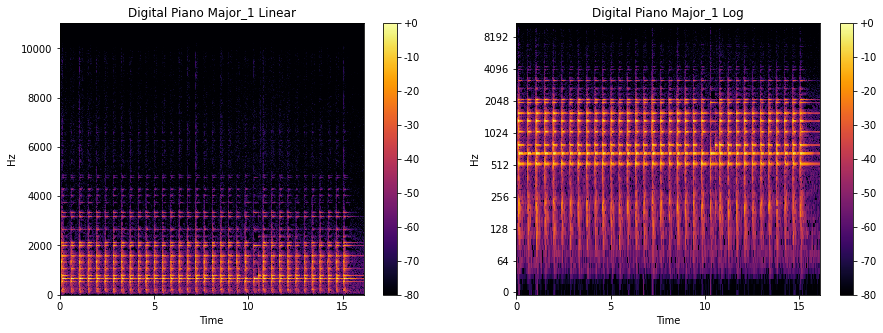

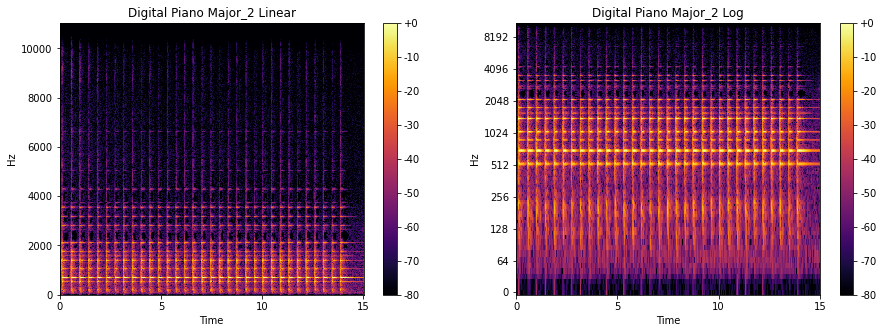

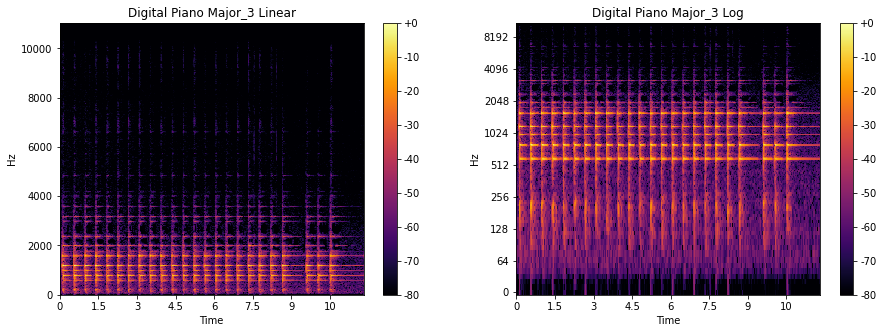

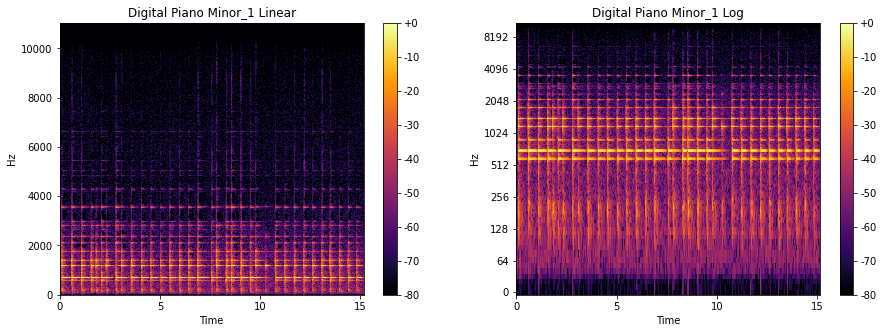

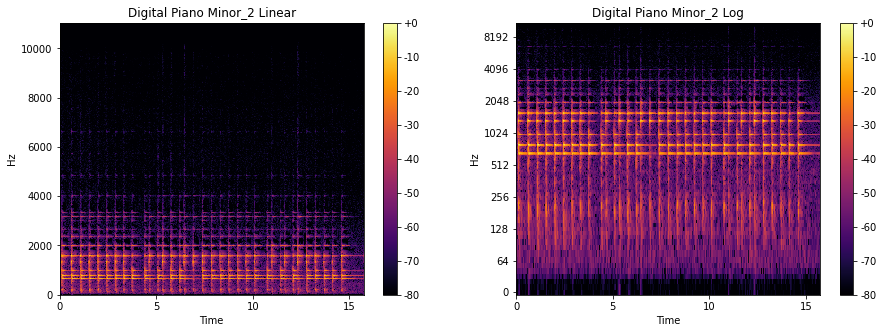

...

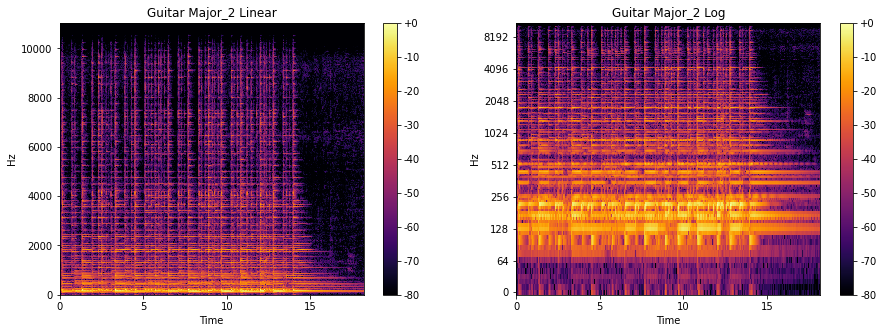

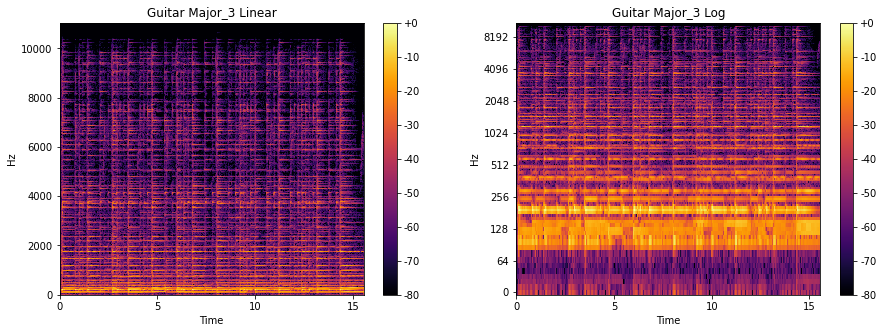

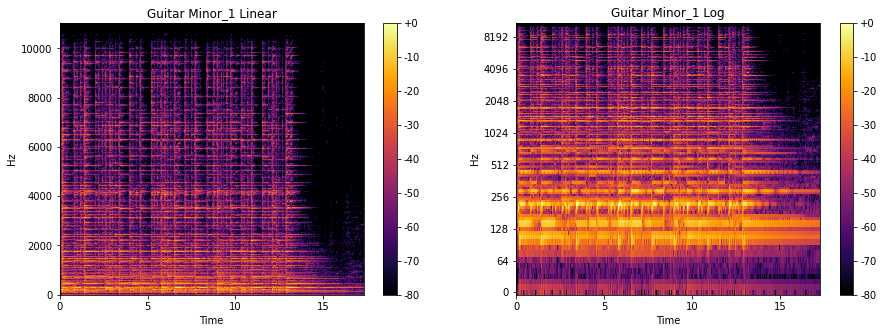

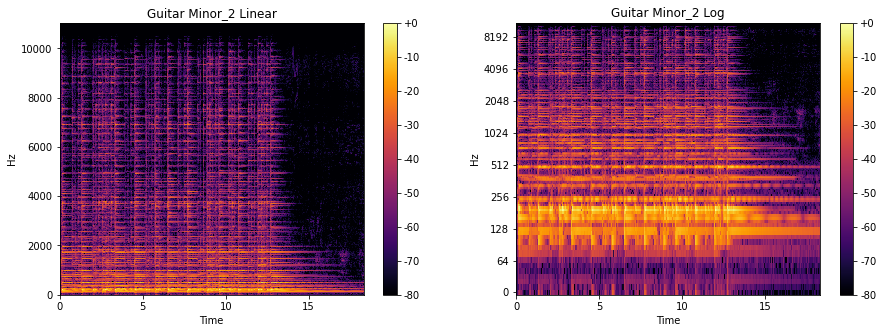

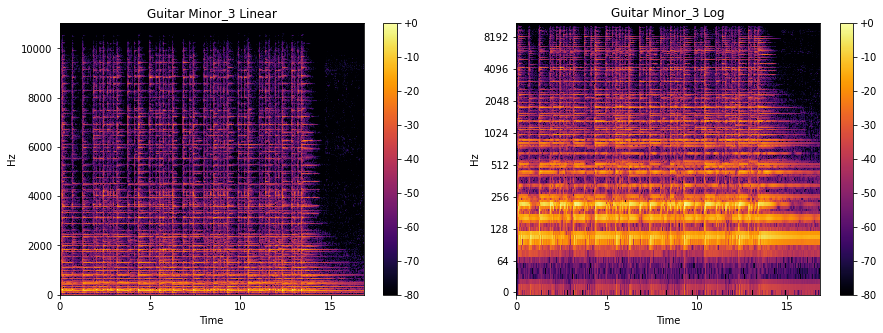

In [30]:
for i, wav in enumerate(audios):
    name = wav.split(".")[0].split("\\")[1]
    file, sr = librosa.load(wav) #load audio
    stft_out = getSTFT(file) 
    spec_out = getSpec(stft_out)
    power_out = getPower(spec_out)
    plt.figure(i+1, figsize=(15,5))
    plot_spectrogram(power_out, sr, HOP_SIZE, 121, name + " Linear")
    plot_spectrogram(power_out, sr, HOP_SIZE, 122, name + " Log", y_axis="log")
    plt.show()

### To-do 2:  Feature Extraction
Encode the whole spectrogram values to a list( 1 for frequency and 1 for intensity) and visualize it using a histogram.  Then create a data frame with the following columns [`frequency`, `intensity`, `chord`]

In [13]:
for i, wav in enumerate(audios):
    name = wav.split(".")[0].split("\\")[1]
    file, sr = librosa.load(wav) #load audio
    stft_out = getSTFT(file) 
    spec_out = getSpec(stft_out)
    power_out = getPower(spec_out)

    plt.figure(1+i, figsize=(10,5))
    plt.subplot(121)
    plt.title(name + "_Frequency Histogram")
    plt.plot(spec_out)

    plt.subplot(122)
    plt.title(name + "_Intensity Histogram")
    plt.plot(power_out)
    plt.show()

NameError: name 'audios' is not defined

In [31]:
# Our hearing range is commonly 20 Hz to 20 kHz
# Starting with 55 Hz which is "A" (I divided 440 by 2 three times)
curr_freq = 55
freq_list = []

# I want to calculate 8 octaves of notes. Each octave has 12 notes. Looping for 96 steps:
for i in range(96): 
    freq_list.append(curr_freq)
    curr_freq *= np.power(2, 1/12) # Multiplying by 2^(1/12)

#reshaping and creating dataframe
freq_array = np.reshape(np.round(freq_list,1), (8, 12))
cols = ["A", "A#", "B", "C", "C#", "D", "D#", "E", "F", "F#", "G", "G#"]
df_note_freqs = pd.DataFrame(freq_array, columns=cols)
print("NOTE FREQUENCIES IN WESTERN MUSIC")
df_note_freqs.head(10)

NOTE FREQUENCIES IN WESTERN MUSIC


,A,A#,B,C,C#,D,D#,E,F,F#,G,G#
0,55.0,58.3,61.7,65.4,69.3,73.4,77.8,82.4,87.3,92.5,98.0,103.8
1,110.0,116.5,123.5,130.8,138.6,146.8,155.6,164.8,174.6,185.0,196.0,207.7
2,220.0,233.1,246.9,261.6,277.2,293.7,311.1,329.6,349.2,370.0,392.0,415.3
3,440.0,466.2,493.9,523.3,554.4,587.3,622.3,659.3,698.5,740.0,784.0,830.6
4,880.0,932.3,987.8,1046.5,1108.7,1174.7,1244.5,1318.5,1396.9,1480.0,1568.0,1661.2
5,1760.0,1864.7,1975.5,2093.0,2217.5,2349.3,2489.0,2637.0,2793.8,2960.0,3136.0,3322.4
6,3520.0,3729.3,3951.1,4186.0,4434.9,4698.6,4978.0,5274.0,5587.7,5919.9,6271.9,6644.9
7,7040.0,7458.6,7902.1,8372.0,8869.8,9397.3,9956.1,10548.1,11175.3,11839.8,12543.9,13289.8


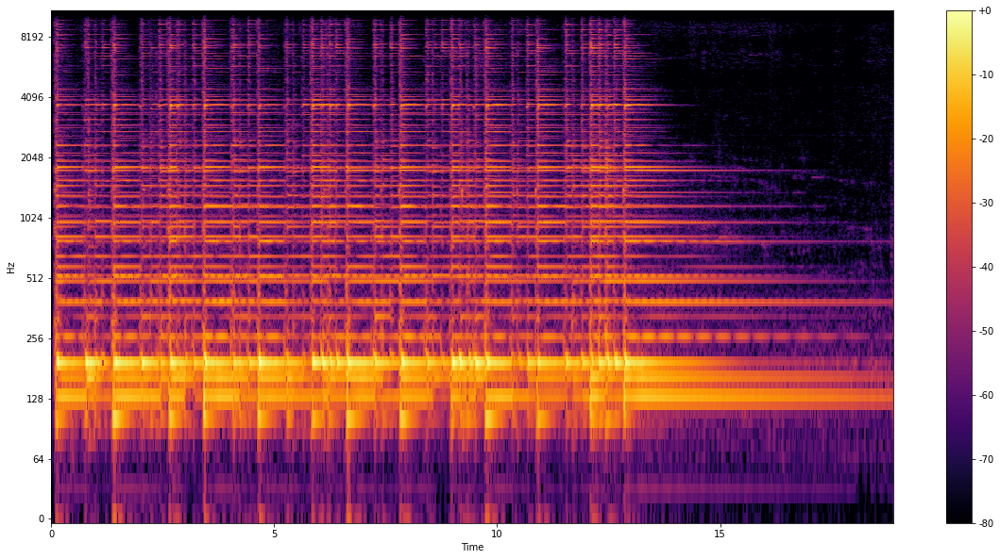

In [65]:
wav = "Audio Chunks/Guitar Major_1.wav"
file, sr = librosa.load(wav) #load audio
stft_out = getSTFT(file) 
spec_out = getSpec(stft_out)
power_out = getPower(spec_out)
amp_out = librosa.amplitude_to_db(spec_out, ref=np.max)
plt.figure(1, figsize=(20,10))
librosa.display.specshow(power_out, y_axis='log', sr=sr, hop_length=512,
                         x_axis='time', cmap='inferno')
plt.colorbar(format="%+2.f")
plt.show()

In [80]:
s, t = spec_out.shape
Data = pd.DataFrame()

for i in range(t):
    df = pd.DataFrame()
    f = spec_out[:,i]
    p = power_out[:,i]
    df['Time'] = [x for x in [i]*1025]
    df['Freq'] = f
    df['Inten'] = p
    df['Chord'] = [i for i in librosa.hz_to_note(f)]
    Data = pd.concat([Data, df])

### To-do 3:  Modelling and Performance Evaluation
Using `decision trees` or `ensemble models` (`scikit learn`), fit a classifier (from the dataframe) using the frequency and intensity as inputs and the chord as output.  Test its accuracy and report if it is sufficient for practical applications.  Check for the predictors (nodes) and report if they could cover the whole spectrum.